In [1]:
import pandas as pd
from stridze.db import engine, get_session
import matplotlib.pyplot as plt
import numpy as np

session = get_session()

In [14]:
records = pd.read_sql_table('records', engine)

(-1.0, 25.0)

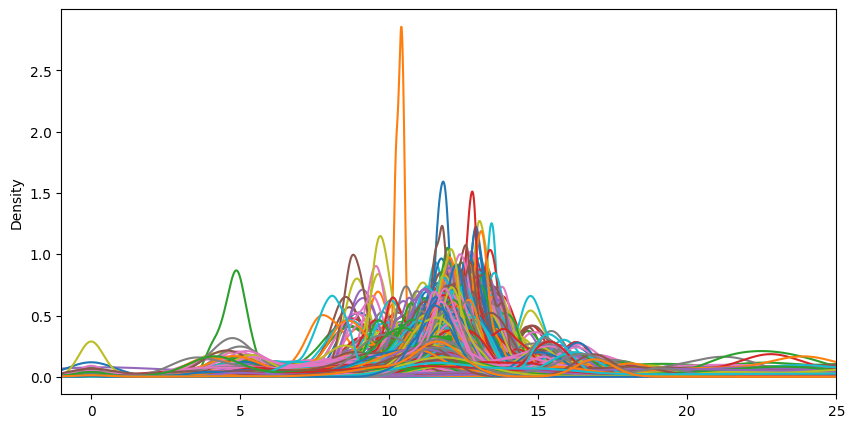

In [32]:
# group records by day from timestamp, and plot kde
fig, ax = plt.subplots(figsize=(10, 5))
records['day'] = records['timestamp'].dt.date
records.enhanced_speed /= 3.6
records.groupby('day')['enhanced_speed'].plot.kde(ax=ax)
ax.set_xlim(-1, 25)

/var/folders/8h/p7tllcw96sv_k_1rvz_4h51m0000gn/T/ipykernel_42673/1794305033.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 5))


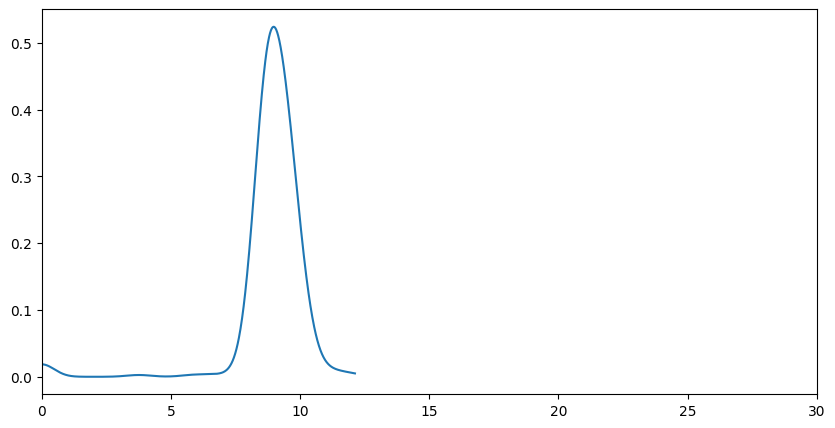

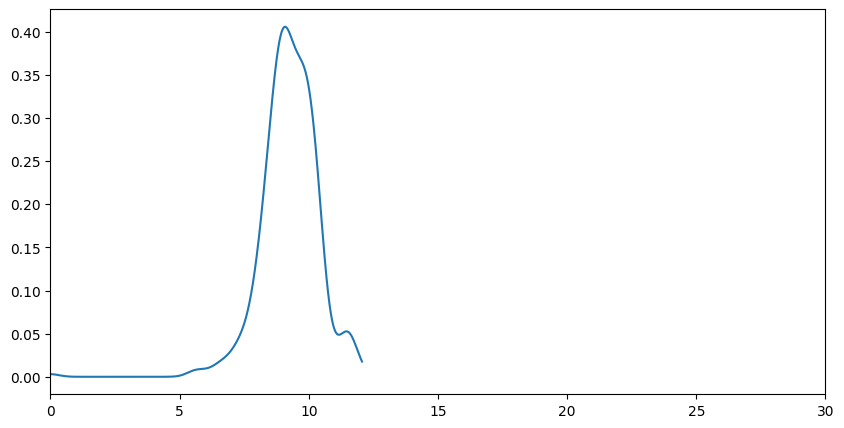

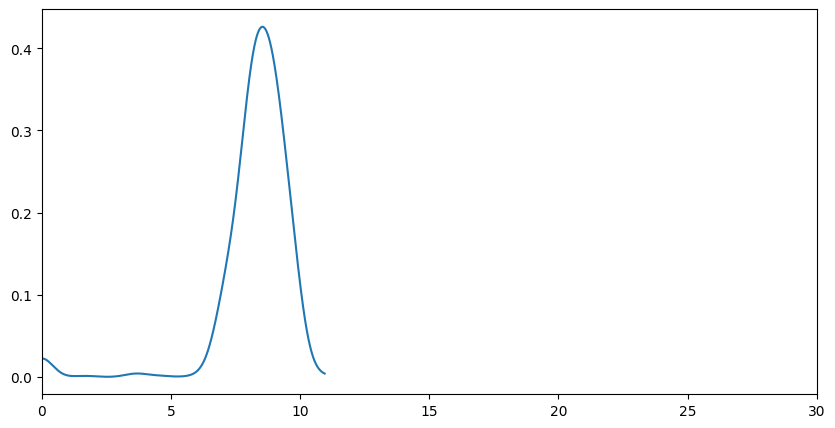

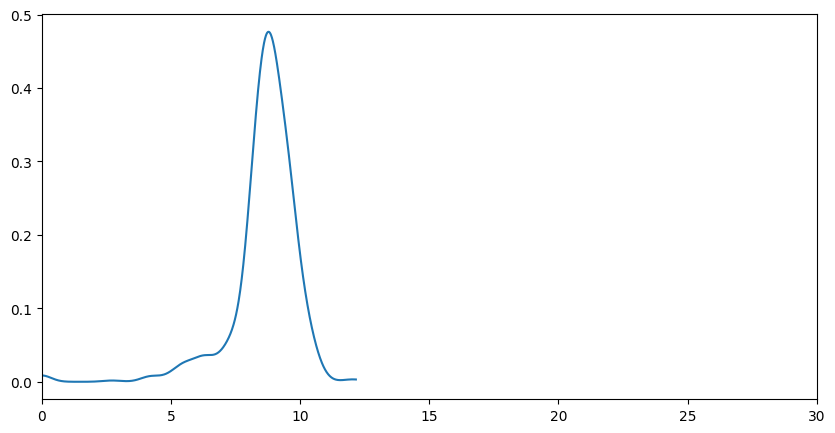

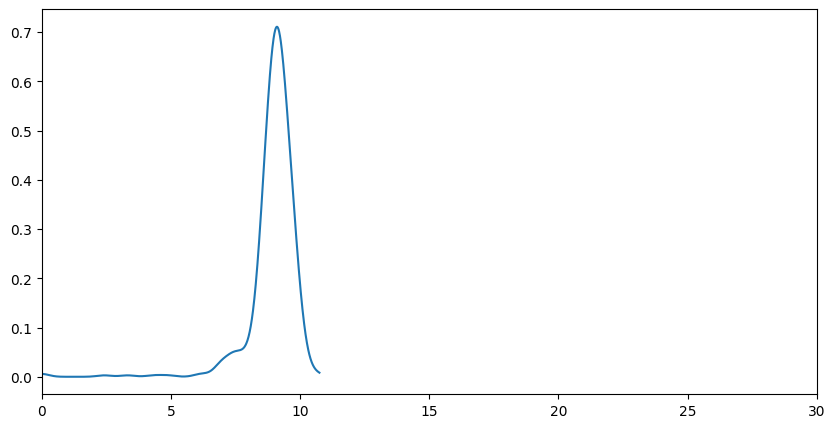

...

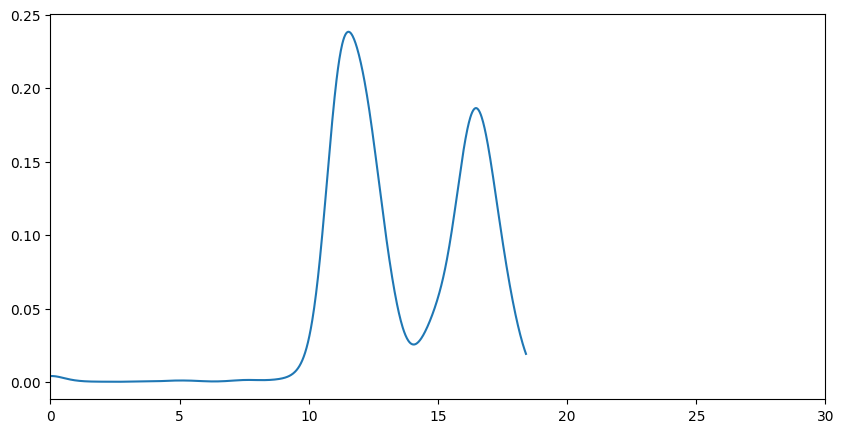

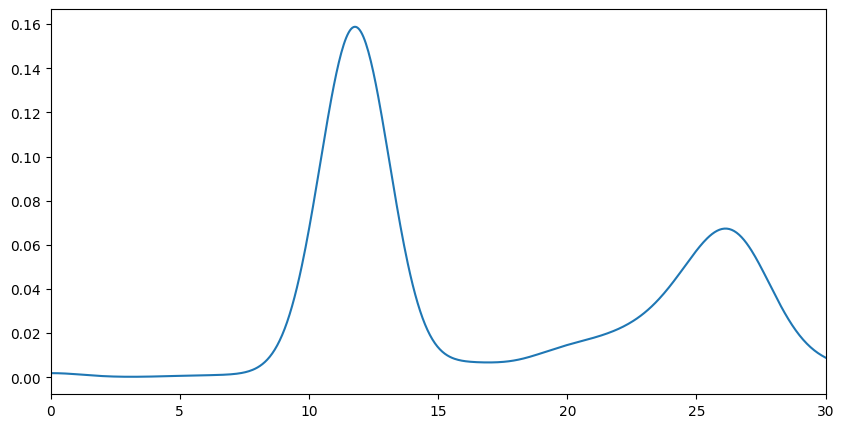

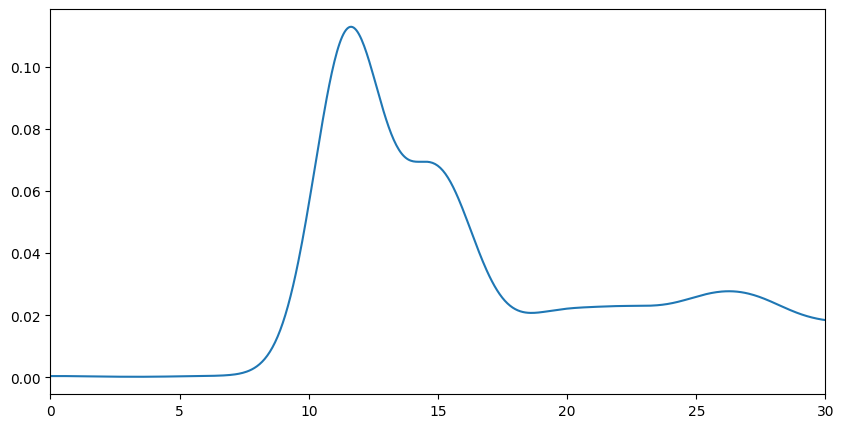

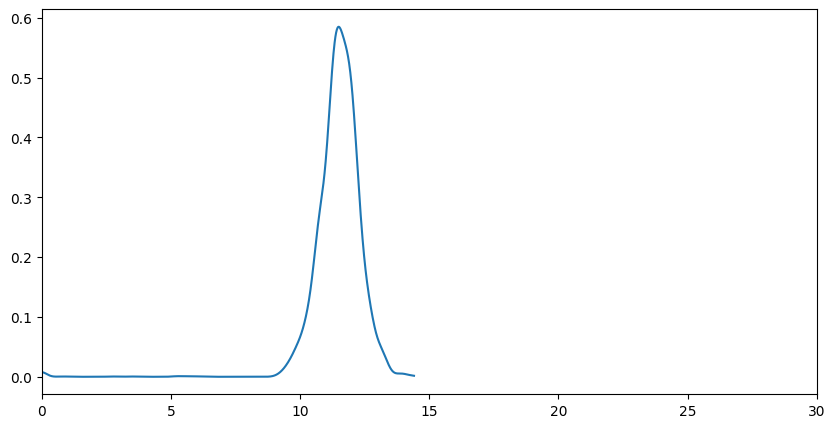

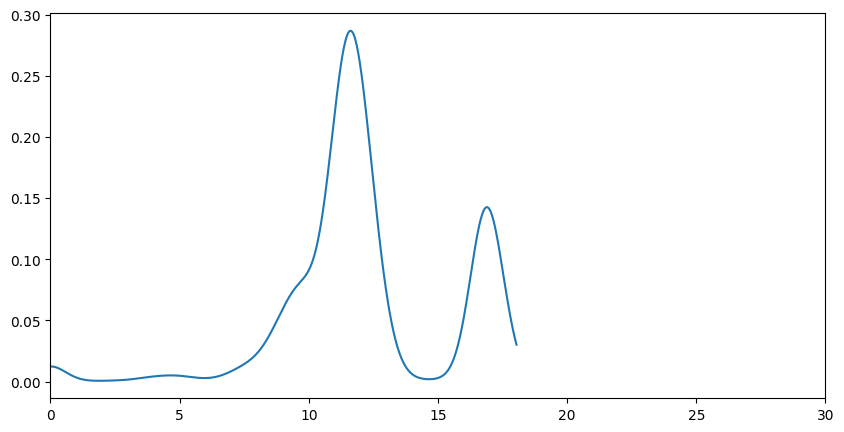

In [48]:
import numpy as np
from scipy.stats import gaussian_kde

# Generate a random dataset
records['day'] = records['timestamp'].dt.date
for _, record in records.groupby('day'):
    fig, ax = plt.subplots(figsize=(10, 5))
    ax.set_xlim(0, 30)
    data = record[~np.isinf(record.enhanced_speed) & ~np.isnan(record.enhanced_speed)].enhanced_speed
    # Calculate the KDE
    kde = gaussian_kde(data)

    # Evaluate the KDE at specific points
    x = np.linspace(data.min(), data.max(), 1000)
    kde_values = kde(x)

    ax.plot(x, kde_values)